Note:
- I need length of the amplitude mapping sequence and the length of the prompt mapping sequence
- 2^La is how the number of images generated per prompt will be determined with 2^Lp  being the maximum number of prompts
- How we obtain prompts was a little fuzzy, so this uses 5 hardcoded prompts
- To my understanding of the paper, we generate 2^La images per prompt

In [5]:
!pip install diffusers accelerate

# Text-to-Image

In [6]:
from diffusers import AutoPipelineForText2Image
import torch

pipe = AutoPipelineForText2Image.from_pretrained("stabilityai/sdxl-turbo", torch_dtype=torch.float16, variant="fp16")
pipe.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/685 [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/459 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.78k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.30.3",
  "_name_or_path": "stabilityai/sdxl-turbo",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerAncestralDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [7]:
from IPython.display import Image, display
import random

In [8]:
#SEinit = initialization value
#SEstep = step size
#calculate_seedVal returns the random seed value for an image generated by xth number prompt

def calculate_seedVal(numPrompt, numImage, SEinit, SEstep):
    SEuv = numPrompt * SEinit + (numImage - 1) * SEstep
    return SEuv

In [15]:
def prompt_user():

    while True:
        try:
            num_images = int(input("Enter the number of images to generate: ")) #Remark: delete once numImage + numPrompts obtained from mapping
            if num_images > 0:  # Ensure a positive integer is entered
                break
            else:
                print("Please enter a positive integer.")
        except ValueError:
            print("Invalid input. Please enter a valid integer.")

    return num_images

In [10]:
# Hardcoded list of prompts
HARD_CODED_PROMPTS = [
    "A scenic landscape of mountains and rivers",
    "Ice cream in a clear glass bowl",
    "Italian city next to a body of water",
    "College campus in space",
    "The Death Star Exploding",
]


In [17]:
#Note, there should be a max of 2^La (length of AM sequence) images
def generate_images(maxImages, max_prompts, steps = 1):
    #shared random seed both sender and receiver have
    shared_seed = 592

    #generate random initial seed values (initialization and step value)
    SEinit = random.uniform(1.0, 100.0)
    SEstep = random.uniform(0.1, 1.0)

    numImage = 1
    numPrompt = 1

    for numPrompt, prompt in enumerate(HARD_CODED_PROMPTS, start=1):
          print("Generating images for Prompt " + str(numPrompt))

          for numImage in range(1, maxImages + 1):
              seed_value = calculate_seedVal(numPrompt, numImage, SEinit, SEstep)
              image = pipe(prompt=prompt, num_inference_steps=steps, guidance_scale=0.0,seed = seed_value).images[0]
              display(image)

          numPrompt+=1
          numImage = 1

'\n    for _ in range(maxImages):\n      seed_value = calculate_seedVal(numPrompt, numImage, SEinit, SEstep)\n      image = pipe(prompt=prompt, num_inference_steps=steps, guidance_scale=0.0,seed = seed_value).images[0]\n      display(image)\n      numImage+=1\n      numPrompt+=1\n'

Enter the number of images to generate: 8
Generating images for Prompt 1


  0%|          | 0/1 [00:00<?, ?it/s]

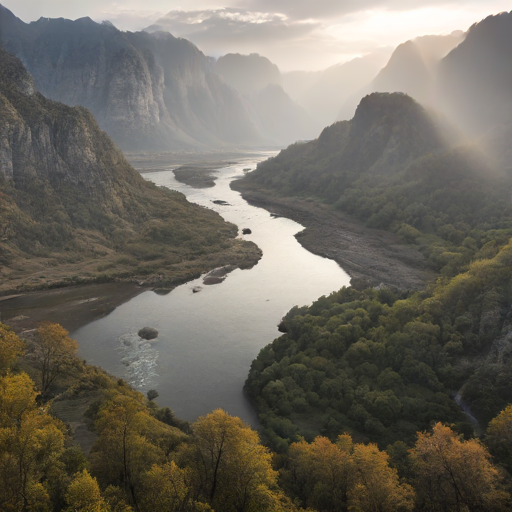

  0%|          | 0/1 [00:00<?, ?it/s]

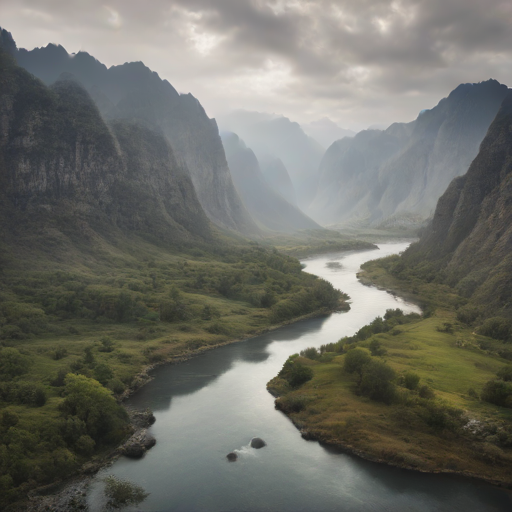

  0%|          | 0/1 [00:00<?, ?it/s]

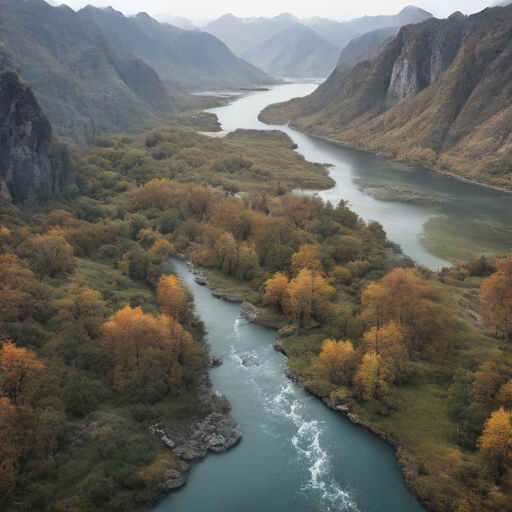

  0%|          | 0/1 [00:00<?, ?it/s]

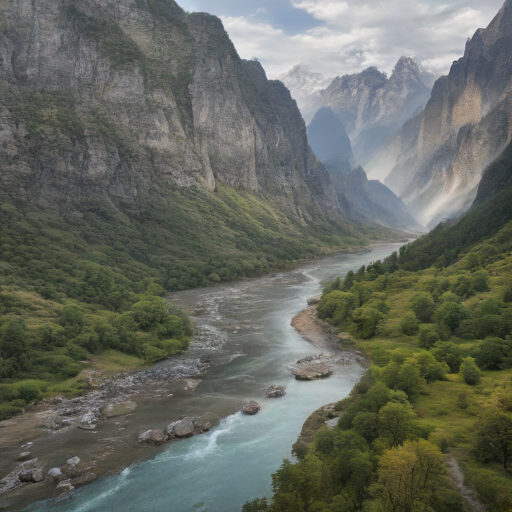

  0%|          | 0/1 [00:00<?, ?it/s]

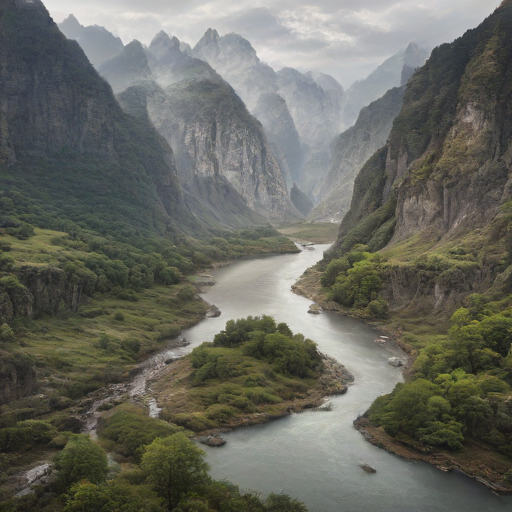

  0%|          | 0/1 [00:00<?, ?it/s]

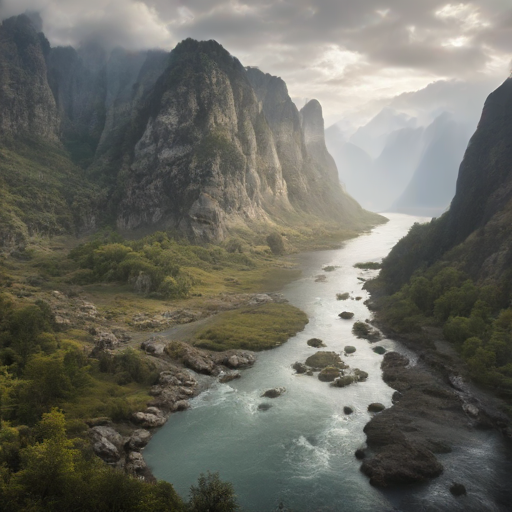

  0%|          | 0/1 [00:00<?, ?it/s]

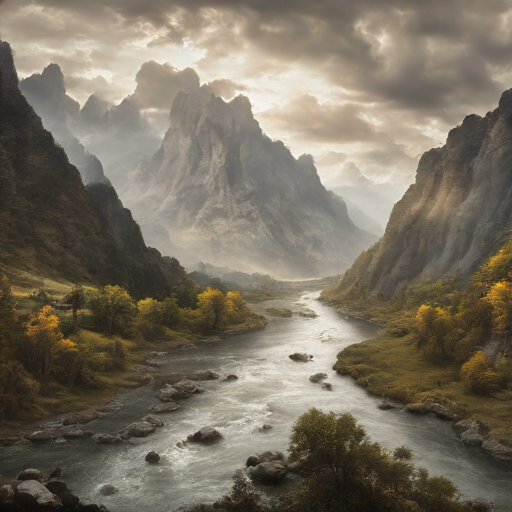

  0%|          | 0/1 [00:00<?, ?it/s]

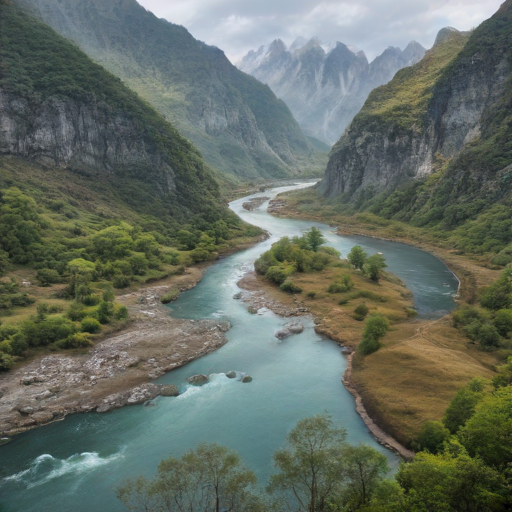

Generating images for Prompt 2


  0%|          | 0/1 [00:00<?, ?it/s]

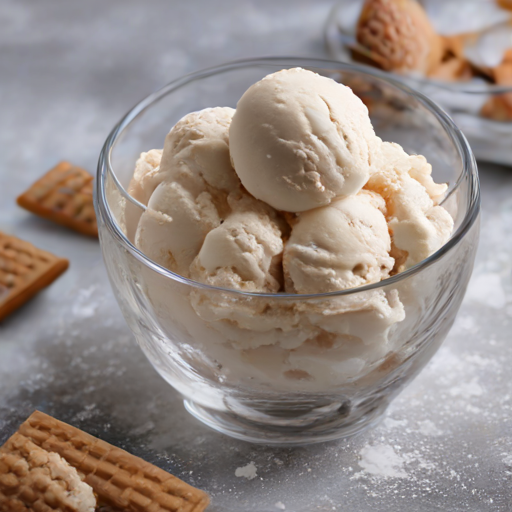

  0%|          | 0/1 [00:00<?, ?it/s]

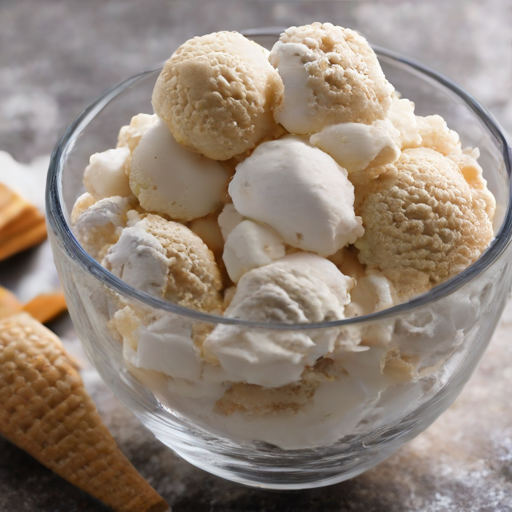

  0%|          | 0/1 [00:00<?, ?it/s]

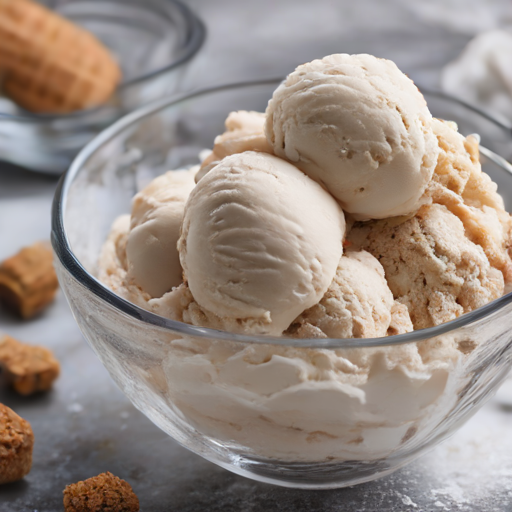

  0%|          | 0/1 [00:00<?, ?it/s]

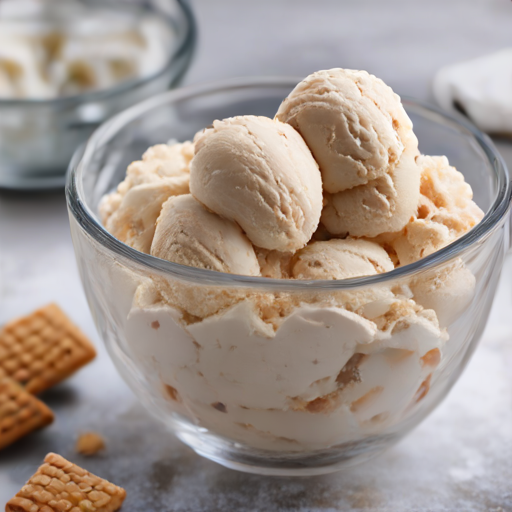

  0%|          | 0/1 [00:00<?, ?it/s]

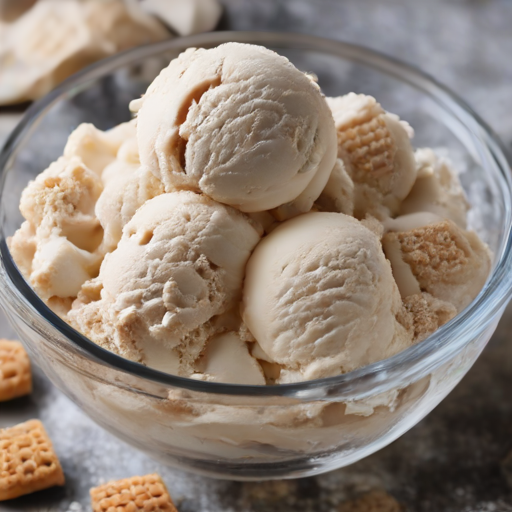

  0%|          | 0/1 [00:00<?, ?it/s]

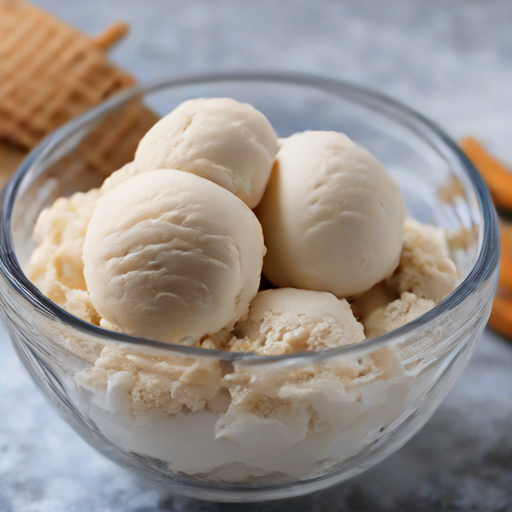

  0%|          | 0/1 [00:00<?, ?it/s]

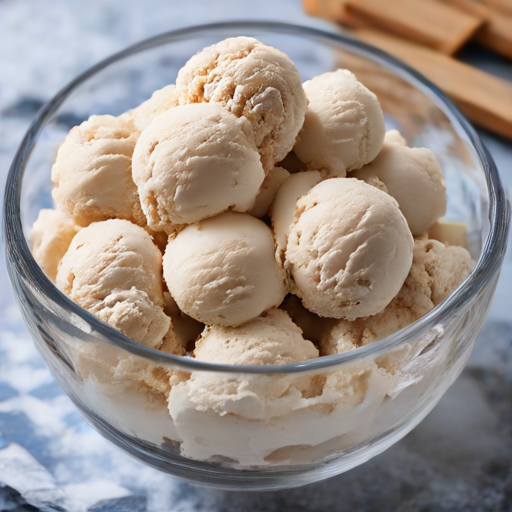

  0%|          | 0/1 [00:00<?, ?it/s]

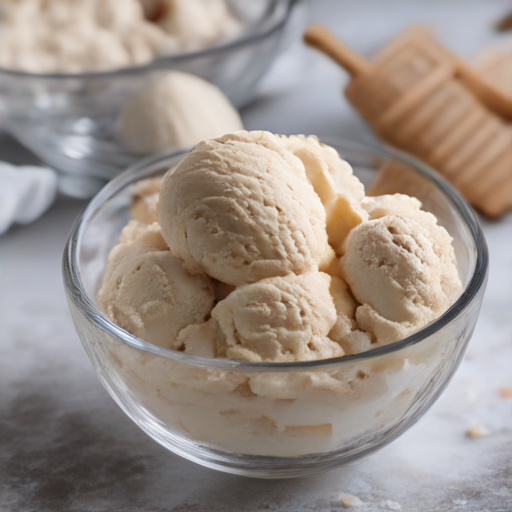

Generating images for Prompt 3


  0%|          | 0/1 [00:00<?, ?it/s]

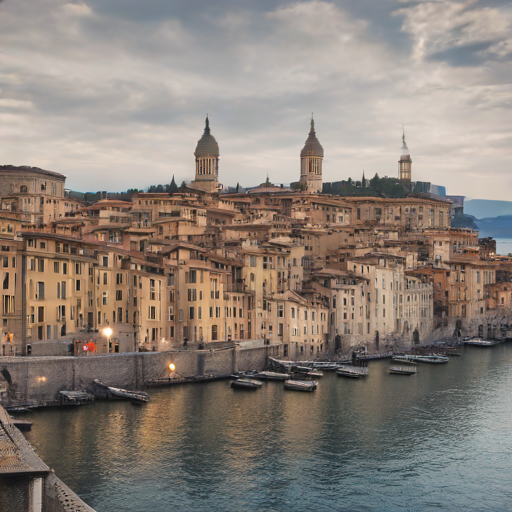

  0%|          | 0/1 [00:00<?, ?it/s]

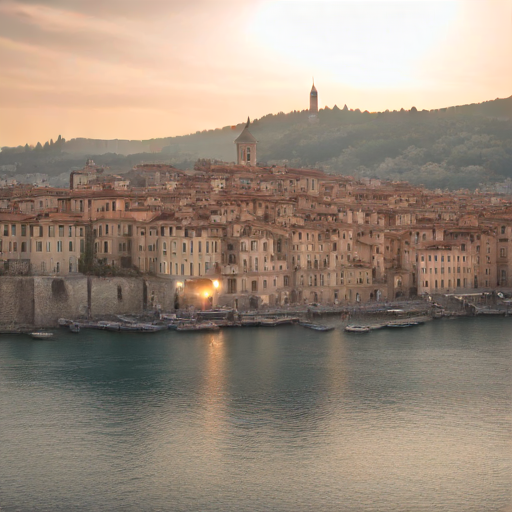

  0%|          | 0/1 [00:00<?, ?it/s]

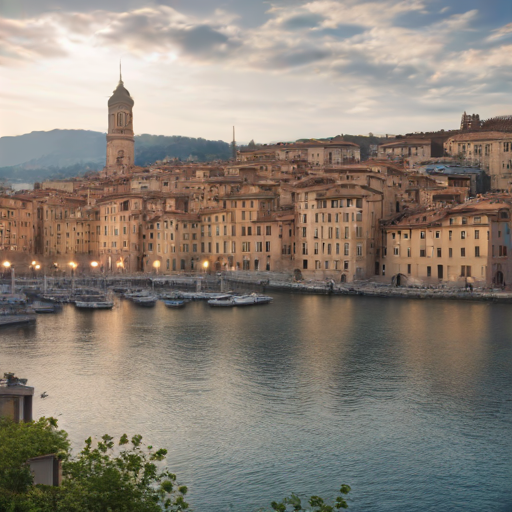

  0%|          | 0/1 [00:00<?, ?it/s]

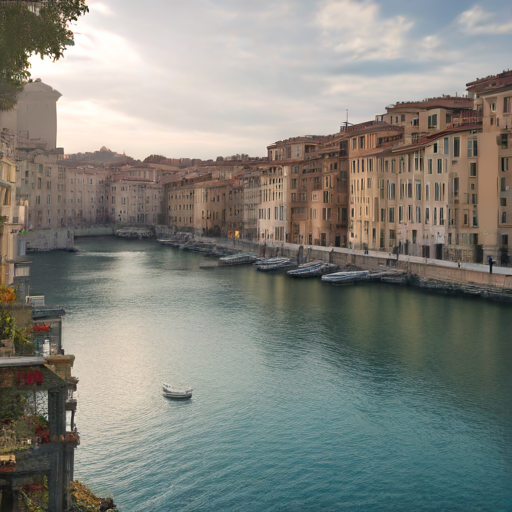

  0%|          | 0/1 [00:00<?, ?it/s]

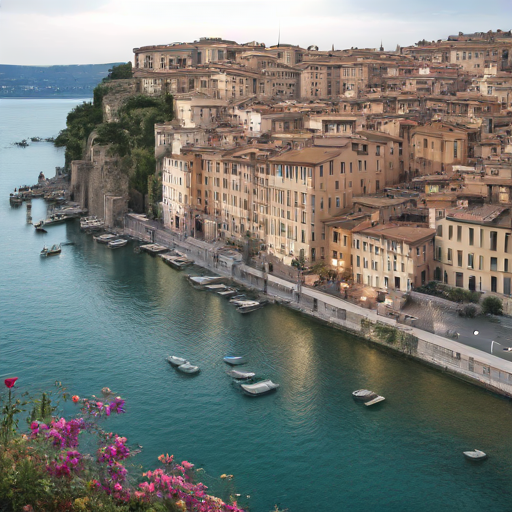

  0%|          | 0/1 [00:00<?, ?it/s]

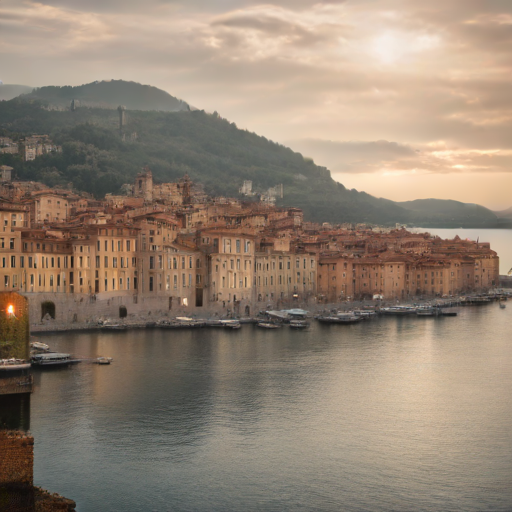

  0%|          | 0/1 [00:00<?, ?it/s]

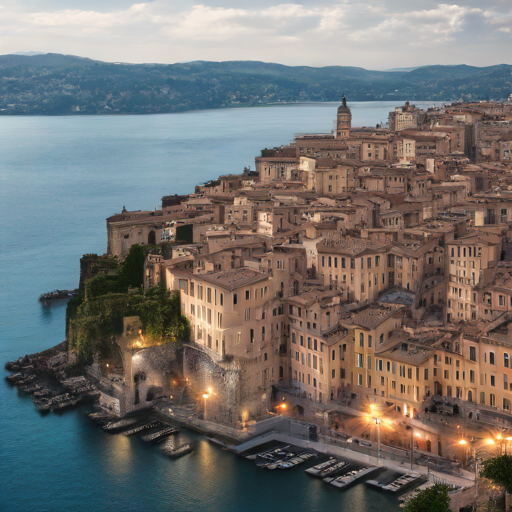

  0%|          | 0/1 [00:00<?, ?it/s]

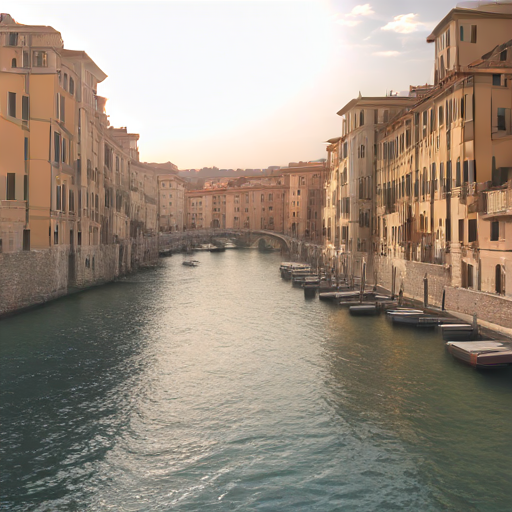

Generating images for Prompt 4


  0%|          | 0/1 [00:00<?, ?it/s]

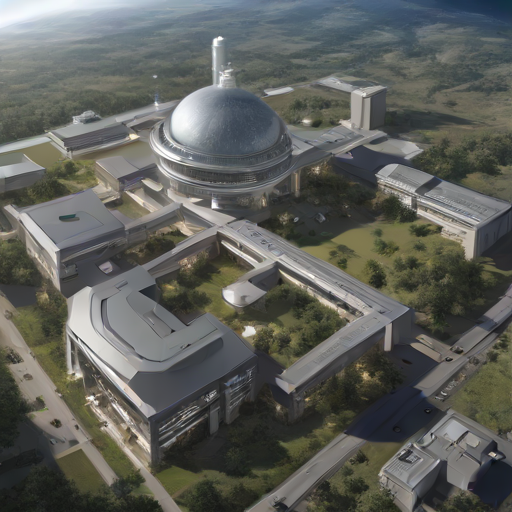

  0%|          | 0/1 [00:00<?, ?it/s]

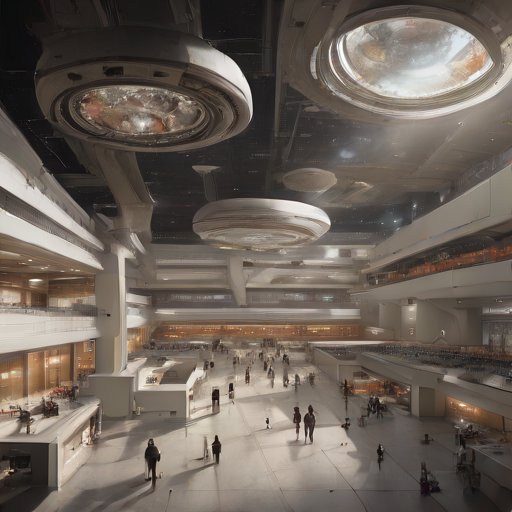

  0%|          | 0/1 [00:00<?, ?it/s]

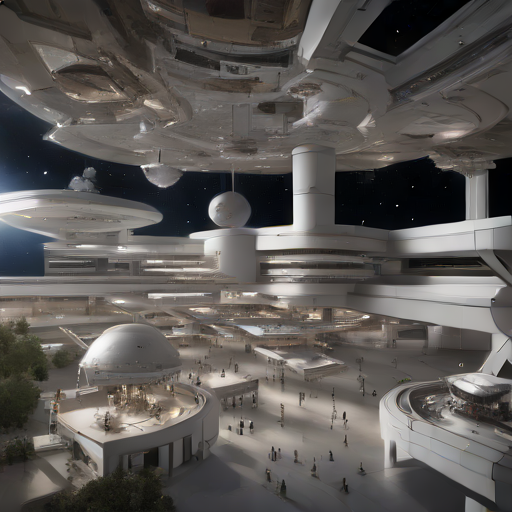

  0%|          | 0/1 [00:00<?, ?it/s]

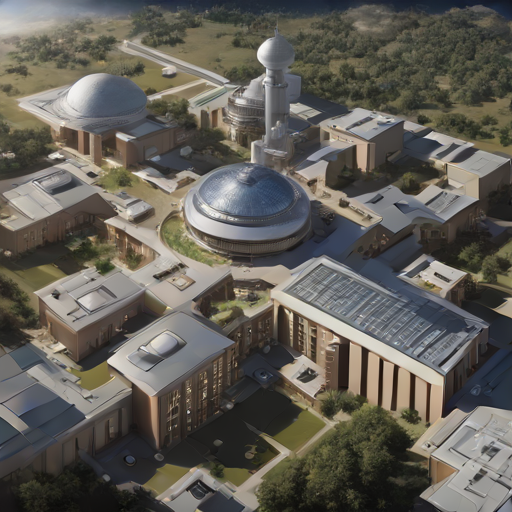

  0%|          | 0/1 [00:00<?, ?it/s]

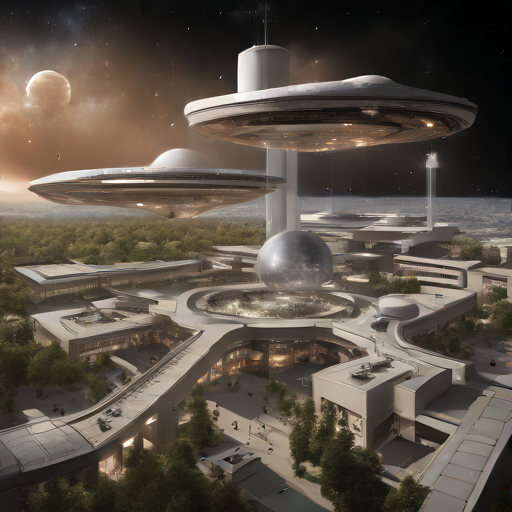

  0%|          | 0/1 [00:00<?, ?it/s]

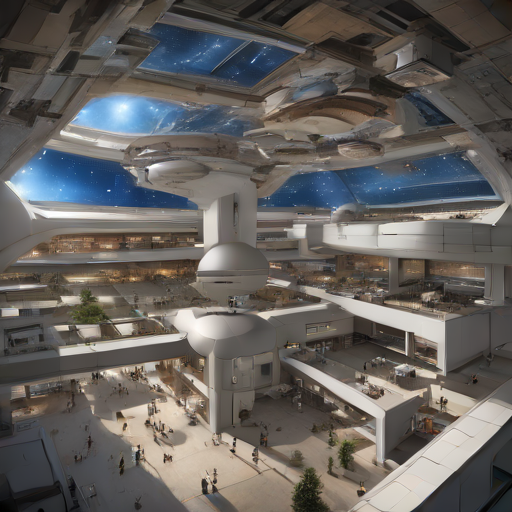

  0%|          | 0/1 [00:00<?, ?it/s]

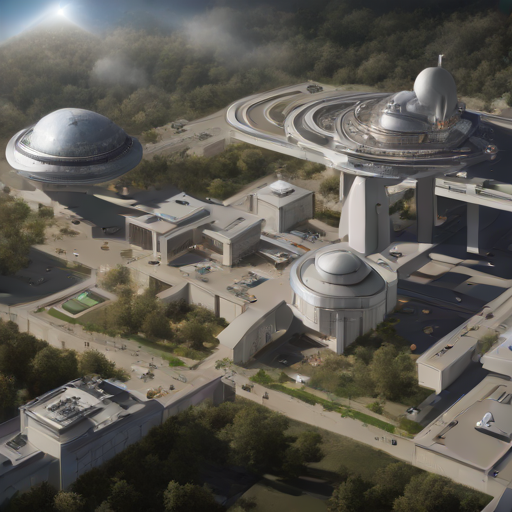

  0%|          | 0/1 [00:00<?, ?it/s]

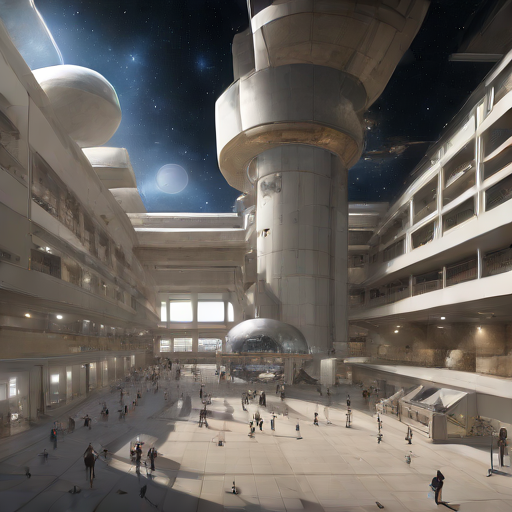

Generating images for Prompt 5


  0%|          | 0/1 [00:00<?, ?it/s]

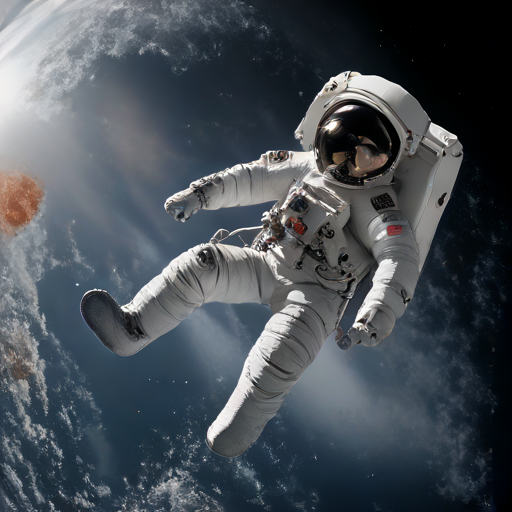

  0%|          | 0/1 [00:00<?, ?it/s]

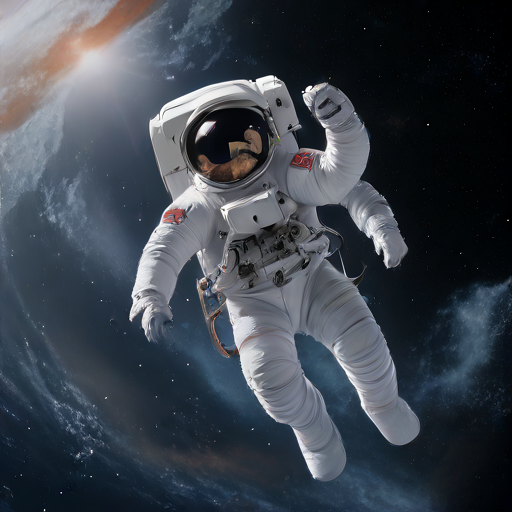

  0%|          | 0/1 [00:00<?, ?it/s]

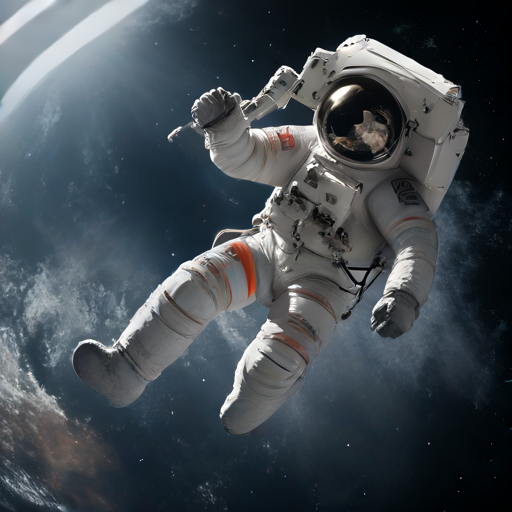

  0%|          | 0/1 [00:00<?, ?it/s]

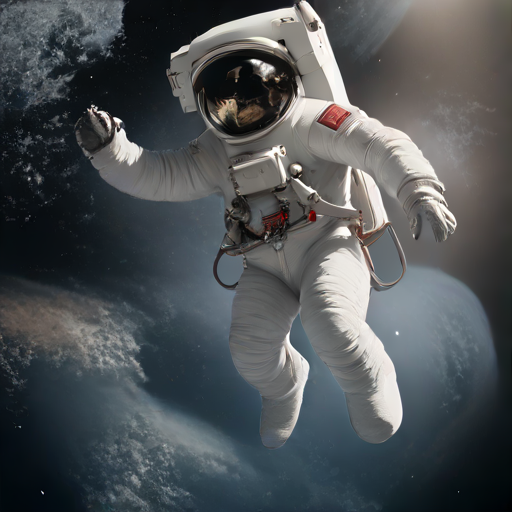

  0%|          | 0/1 [00:00<?, ?it/s]

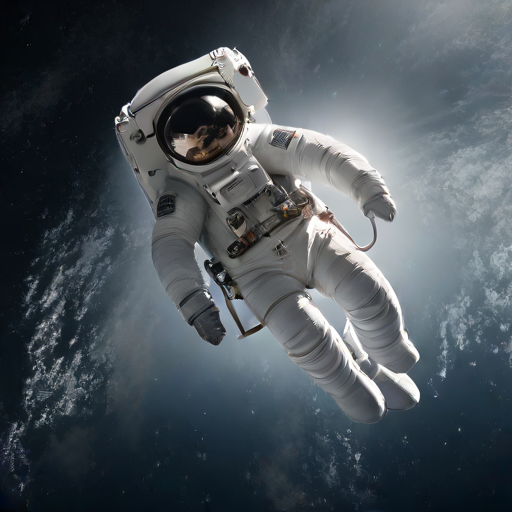

  0%|          | 0/1 [00:00<?, ?it/s]

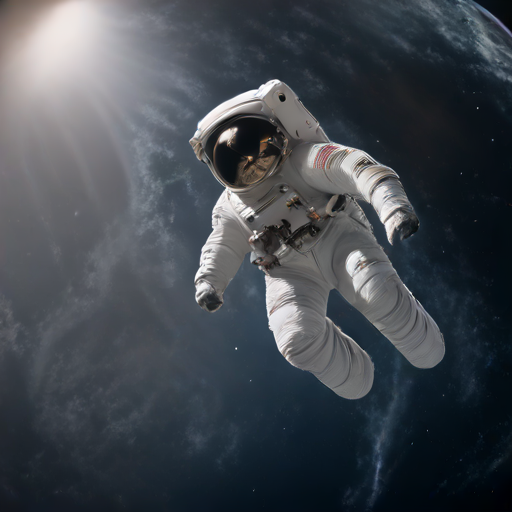

  0%|          | 0/1 [00:00<?, ?it/s]

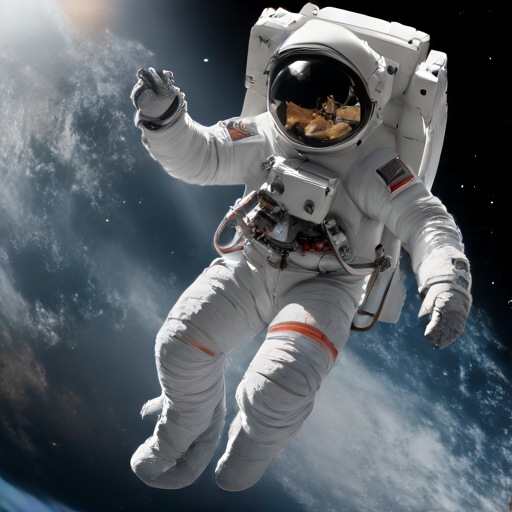

  0%|          | 0/1 [00:00<?, ?it/s]

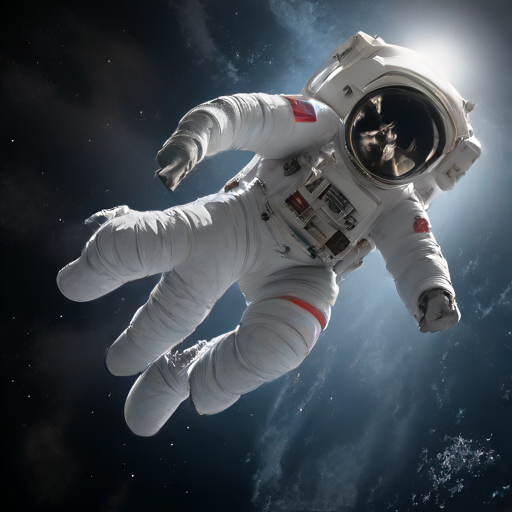

In [19]:

#for testing
max_images = prompt_user()
max_prompts = 5                     ##placeholder
generate_images(max_images, max_prompts, steps=1)
